In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!unzip /content/drive/MyDrive/galaxy-zoo-the-galaxy-challenge.zip

Archive:  /content/drive/MyDrive/galaxy-zoo-the-galaxy-challenge.zip
  inflating: all_ones_benchmark.zip  
  inflating: all_zeros_benchmark.zip  
  inflating: central_pixel_benchmark.zip  
  inflating: images_test_rev1.zip    
  inflating: images_training_rev1.zip  
  inflating: training_solutions_rev1.zip  


In [3]:
!unzip /content/images_training_rev1.zip

Streaming output truncated to the last 5000 lines.
  inflating: images_training_rev1/926425.jpg  
  inflating: images_training_rev1/926426.jpg  
  inflating: images_training_rev1/926435.jpg  
  inflating: images_training_rev1/926446.jpg  
  inflating: images_training_rev1/926448.jpg  
  inflating: images_training_rev1/926453.jpg  
  inflating: images_training_rev1/926462.jpg  
  inflating: images_training_rev1/926478.jpg  
  inflating: images_training_rev1/926480.jpg  
  inflating: images_training_rev1/926484.jpg  
  inflating: images_training_rev1/926488.jpg  
  inflating: images_training_rev1/926509.jpg  
  inflating: images_training_rev1/926522.jpg  
  inflating: images_training_rev1/926544.jpg  
  inflating: images_training_rev1/926547.jpg  
  inflating: images_training_rev1/926548.jpg  
  inflating: images_training_rev1/926551.jpg  
  inflating: images_training_rev1/926602.jpg  
  inflating: images_training_rev1/926630.jpg  
  inflating: images_training_rev1/926649.jpg  
  inflati

In [4]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from tqdm import tqdm
import torchvision.datasets as datasets
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import torchvision.utils as vutils
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Subset
import numpy as np
from torchvision.utils import save_image
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
os.makedirs("generated_images", exist_ok=True)
from torchvision import datasets, transforms

import os
from PIL import Image
from torch.utils.data import Dataset

In [5]:
folder_name = "data"
os.makedirs(folder_name, exist_ok=True)
!mv /content/images_training_rev1 /content/data

Image 1 - Original Shape: (424, 424)
Image 2 - Original Shape: (424, 424)
Image 3 - Original Shape: (424, 424)
Image 4 - Original Shape: (424, 424)
Image 5 - Original Shape: (424, 424)


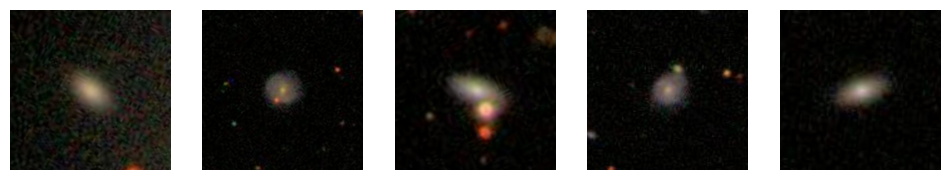

In [6]:
images_directory = '/content/data/images_training_rev1'


def show_original_images(image_paths):
    num_images = len(image_paths)
    fig, axes = plt.subplots(1, num_images, figsize=(12, 4))
    for i, image_path in enumerate(image_paths):
        img = Image.open(os.path.join(images_directory, image_path))
        original_shape = img.size
        axes[i].imshow(img)
        axes[i].axis('off')
        print(f"Image {i+1} - Original Shape: {original_shape}")
    plt.show()


image_files = os.listdir(images_directory)[:5]
show_original_images(image_files)

#DC GAN architecture

In [7]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
LEARNING_RATE = 2e-4
BATCH_SIZE = 128
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 5
FEATURES_DISC = 64
FEATURES_GEN = 64

In [8]:
transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataset = datasets.ImageFolder('/content/data', transform=transform)
dataloader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE, shuffle=True)

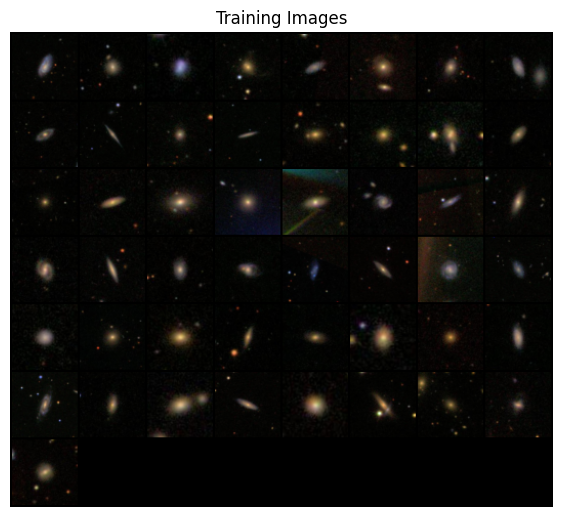

In [9]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(7,7))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:49], padding=2, normalize=True).cpu(),(1,2,0)))

In [10]:
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            self._block(z_dim, features_g * 16, 4, 1, 0),
            self._block(features_g * 16, features_g * 8, 4, 2, 1),
            self._block(features_g * 8, features_g * 4, 4, 2, 1),
            self._block(features_g * 4, features_g * 2, 4, 2, 1),
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            nn.Tanh()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, x):
        return self.net(x)

In [11]:
class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x):
        return self.disc(x)

In [12]:
def initialize_weights(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

In [13]:
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)

initialize_weights(gen)
initialize_weights(disc)

In [14]:
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
criterion = nn.BCELoss()

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)

In [15]:
def show_tensor_images(image_tensor, num_images=32, size=(1, 64, 64)):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=4)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

In [16]:
def save_and_display_images(fake_images, epoch,batch_idx):
    save_image(fake_images[:32], f"generated_images/epoch_{epoch}-{batch_idx}.png", nrow=8, normalize=True)

    img = plt.imread(f"generated_images/epoch_{epoch}-{batch_idx}.png")
    plt.figure(figsize=(7, 7))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Generated Images at Epoch {epoch}")
    plt.show()


Epoch [0/5] Batch 0/482                   Loss D: 0.6140, loss G: 2.3279


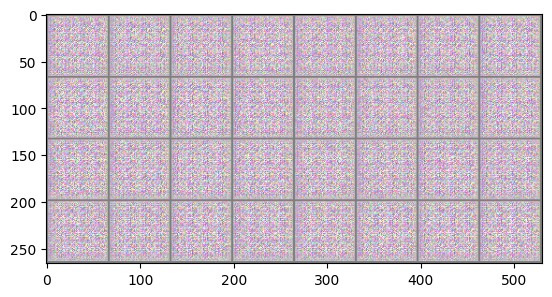

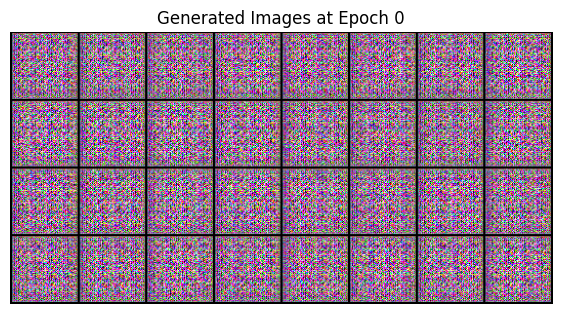

Epoch [0/5] Batch 50/482                   Loss D: 0.0062, loss G: 6.8367


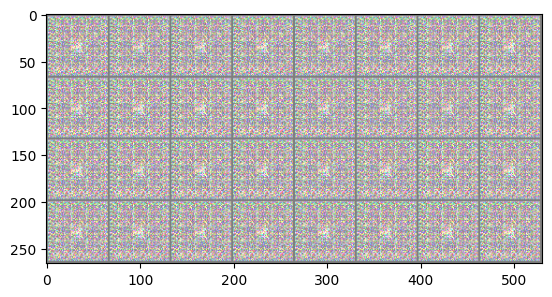

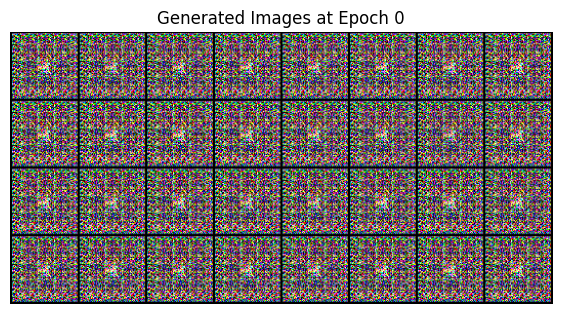

Epoch [0/5] Batch 100/482                   Loss D: 0.0033, loss G: 7.1423


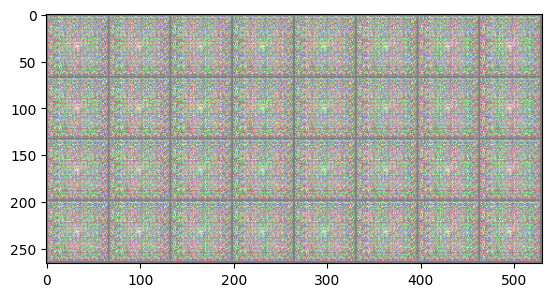

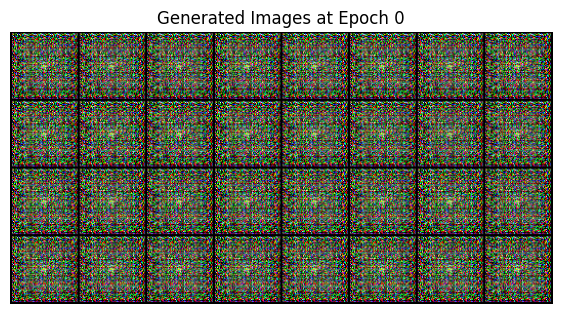

Epoch [0/5] Batch 150/482                   Loss D: 0.0012, loss G: 7.1059


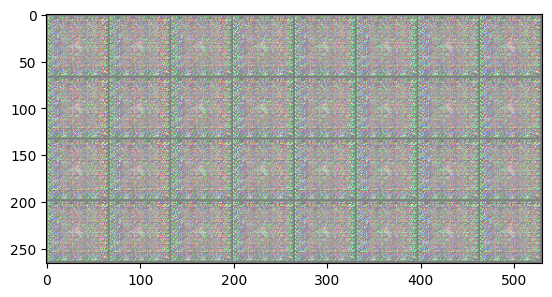

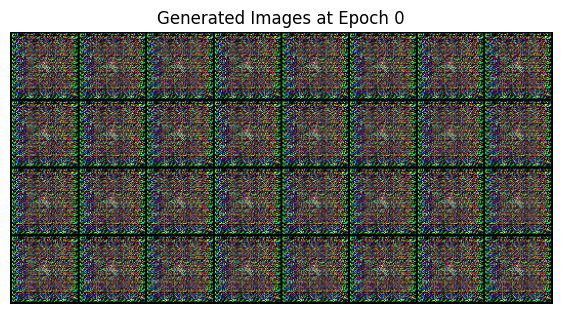

Epoch [0/5] Batch 200/482                   Loss D: 0.1682, loss G: 8.4269


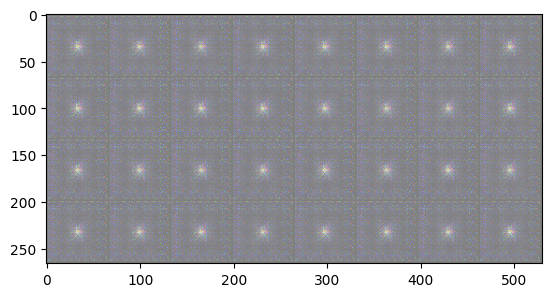

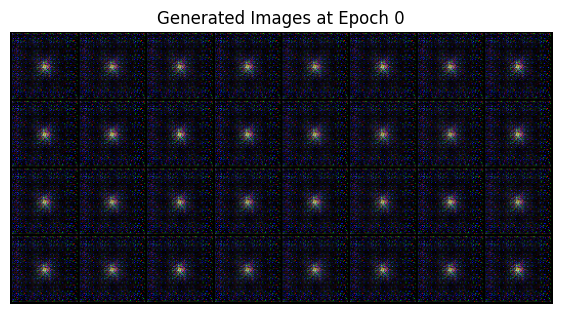

Epoch [0/5] Batch 250/482                   Loss D: 0.0246, loss G: 6.5076


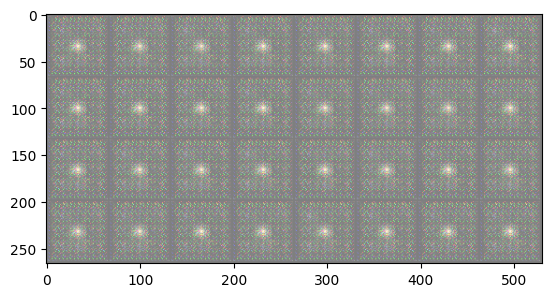

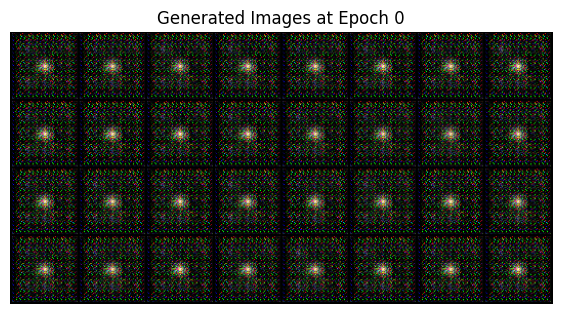

Epoch [0/5] Batch 300/482                   Loss D: 0.6658, loss G: 1.1148


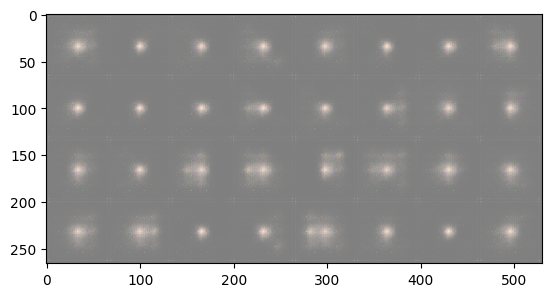

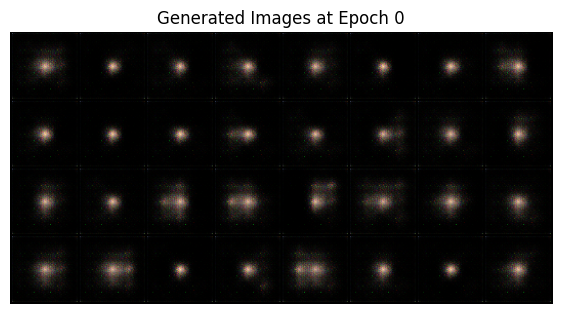

Epoch [0/5] Batch 350/482                   Loss D: 0.6296, loss G: 0.5807


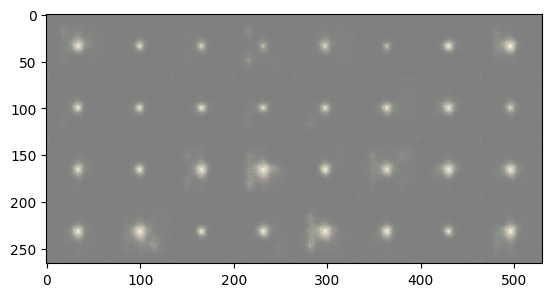

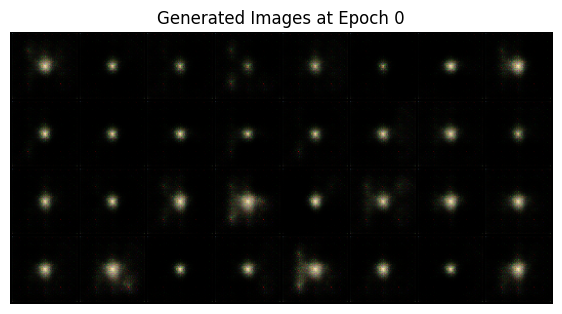

Epoch [0/5] Batch 400/482                   Loss D: 0.5439, loss G: 1.6580


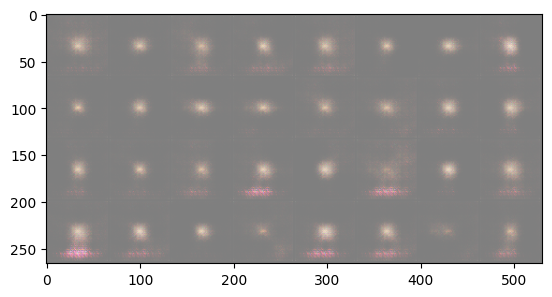

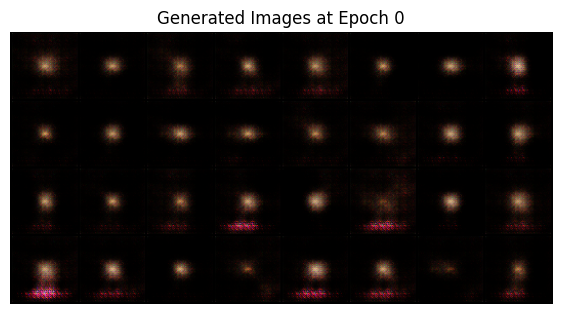

Epoch [0/5] Batch 450/482                   Loss D: 0.6644, loss G: 1.4418


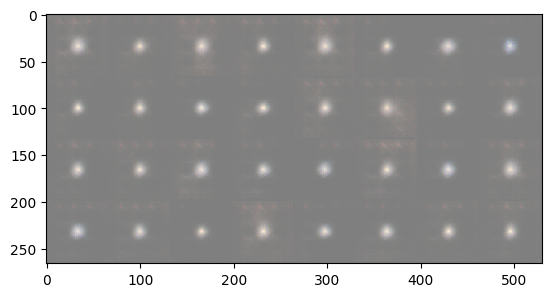

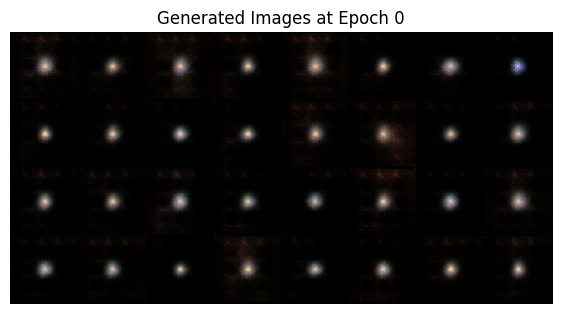

Epoch [1/5] Batch 0/482                   Loss D: 0.4669, loss G: 1.6129


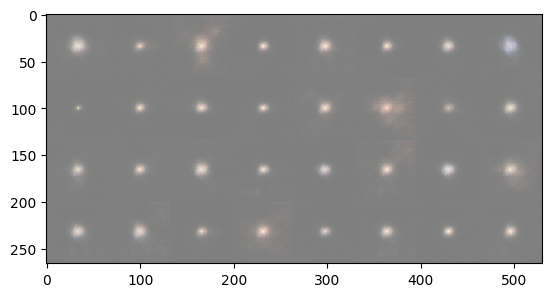

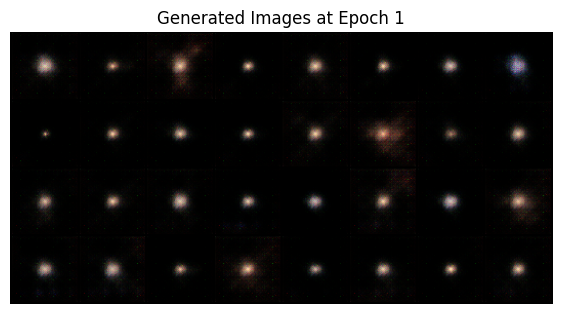

Epoch [1/5] Batch 50/482                   Loss D: 0.5793, loss G: 4.5693


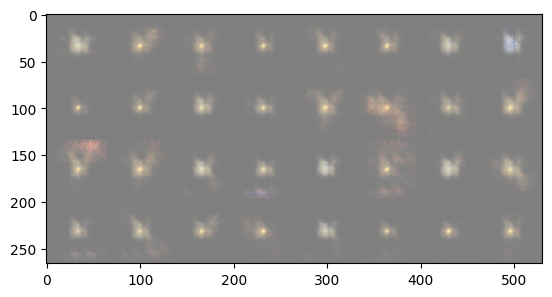

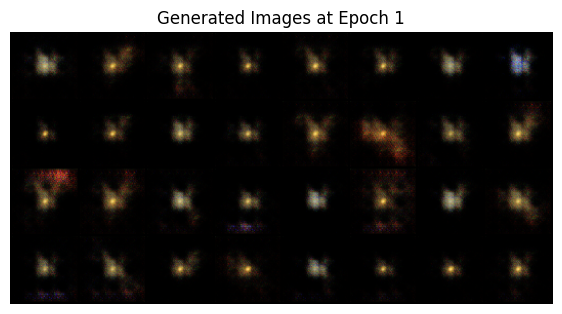

Epoch [1/5] Batch 100/482                   Loss D: 0.7773, loss G: 0.4905


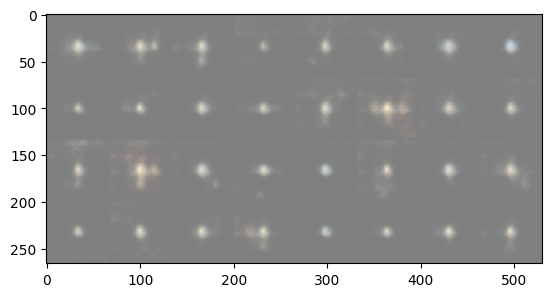

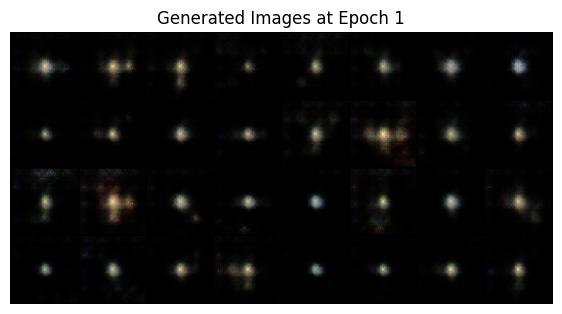

Epoch [1/5] Batch 150/482                   Loss D: 0.4789, loss G: 1.7828


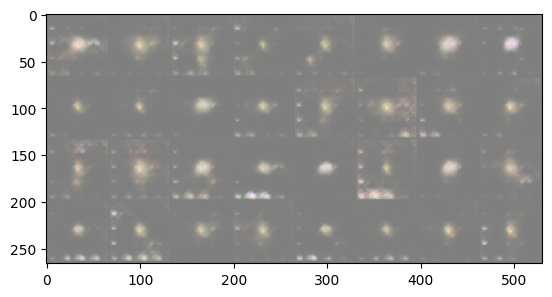

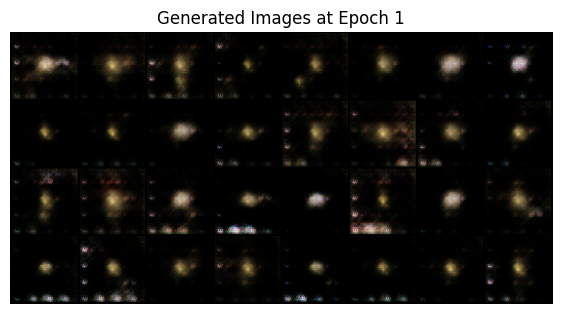

Epoch [1/5] Batch 200/482                   Loss D: 0.3846, loss G: 1.9650


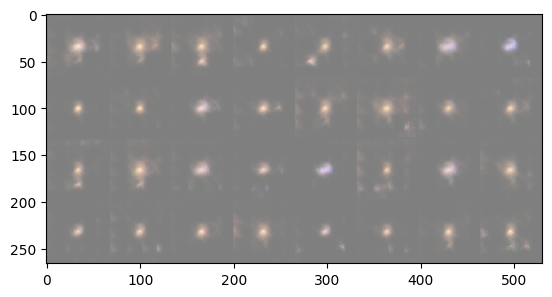

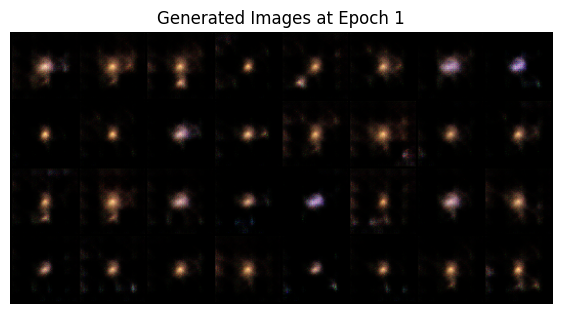

Epoch [1/5] Batch 250/482                   Loss D: 0.5947, loss G: 1.1791


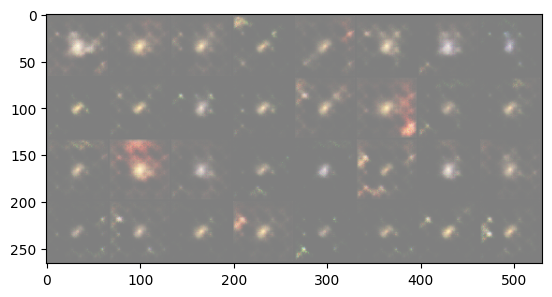

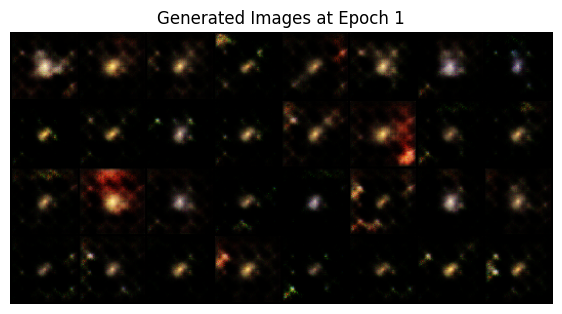

Epoch [1/5] Batch 300/482                   Loss D: 0.6045, loss G: 1.1010


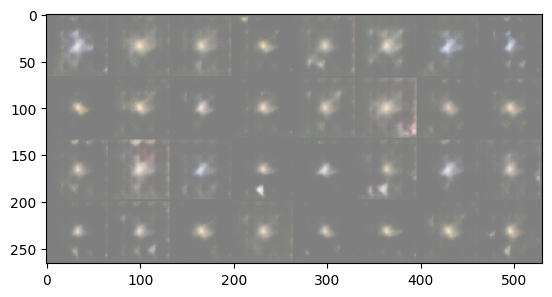

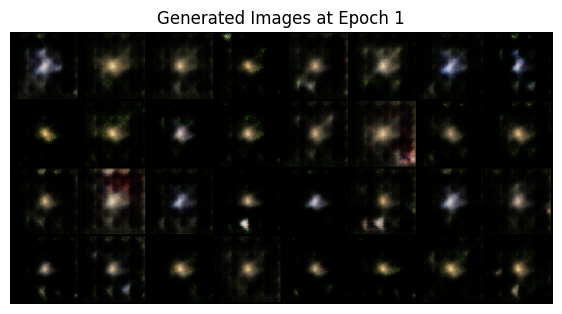

Epoch [1/5] Batch 350/482                   Loss D: 0.4066, loss G: 2.1093


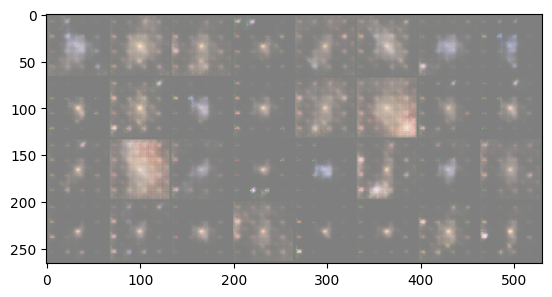

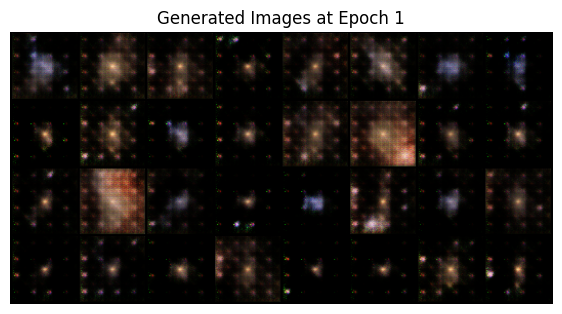

Epoch [1/5] Batch 400/482                   Loss D: 0.4530, loss G: 1.9566


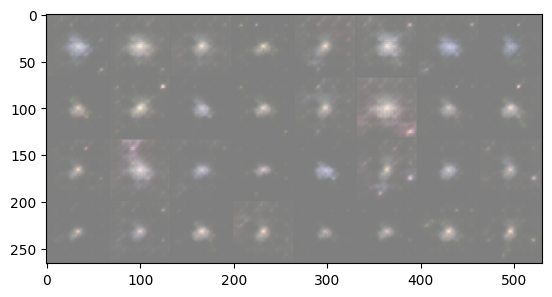

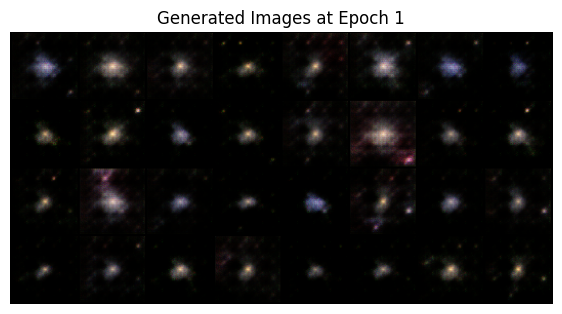

Epoch [1/5] Batch 450/482                   Loss D: 0.5429, loss G: 1.9494


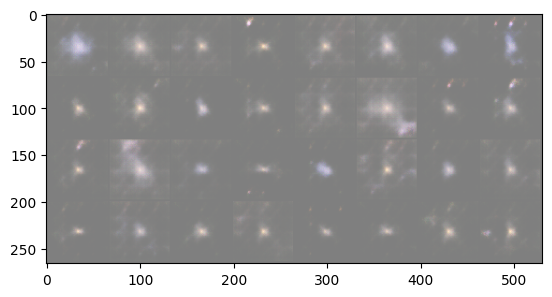

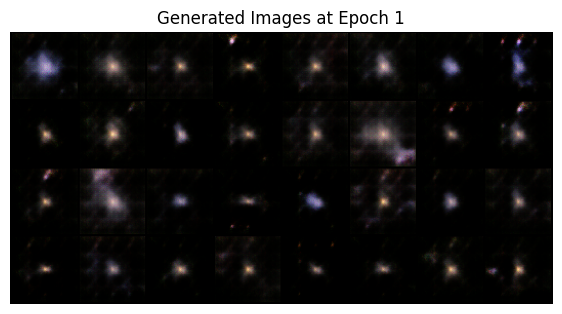

Epoch [2/5] Batch 0/482                   Loss D: 0.6346, loss G: 1.0823


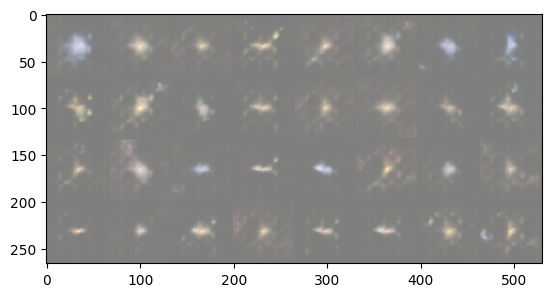

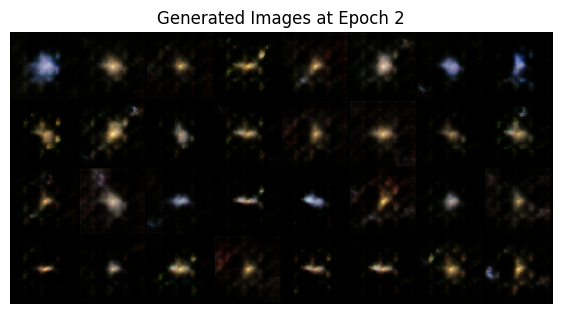

Epoch [2/5] Batch 50/482                   Loss D: 0.8545, loss G: 4.1490


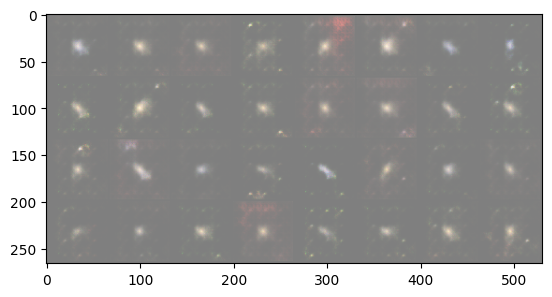

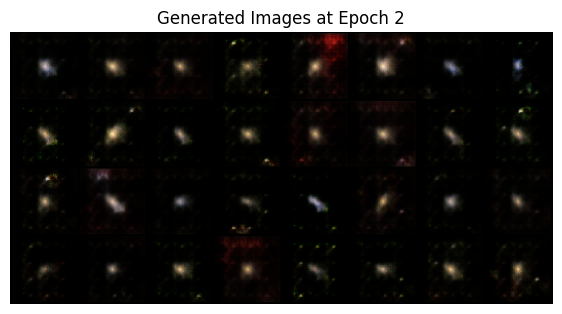

Epoch [2/5] Batch 100/482                   Loss D: 0.4533, loss G: 1.4543


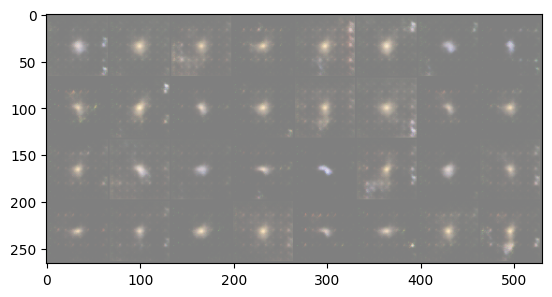

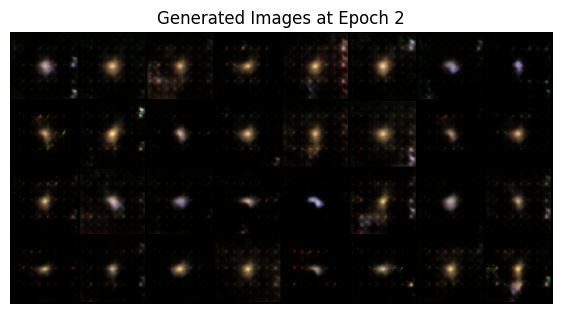

Epoch [2/5] Batch 150/482                   Loss D: 0.3308, loss G: 2.0543


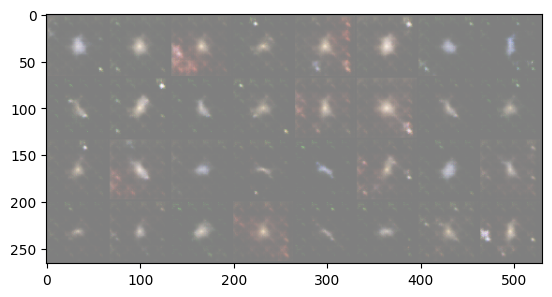

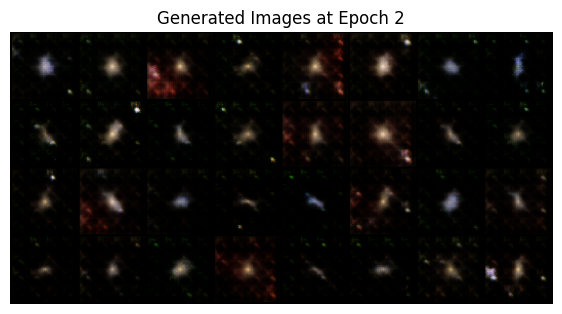

Epoch [2/5] Batch 200/482                   Loss D: 0.6958, loss G: 1.9391


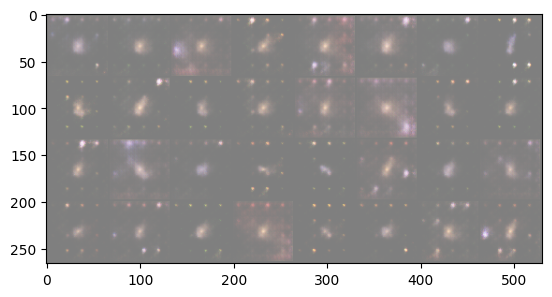

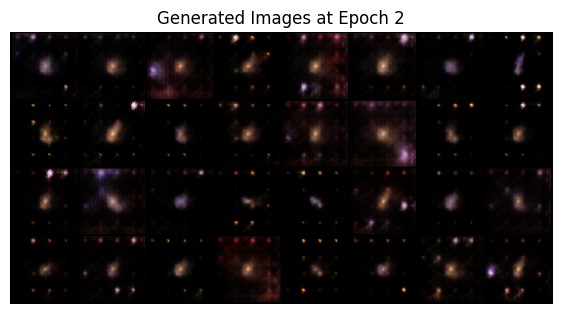

Epoch [2/5] Batch 250/482                   Loss D: 0.4990, loss G: 2.5978


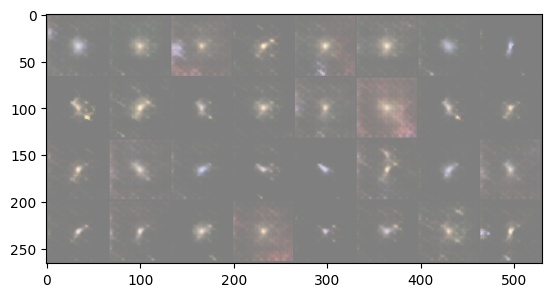

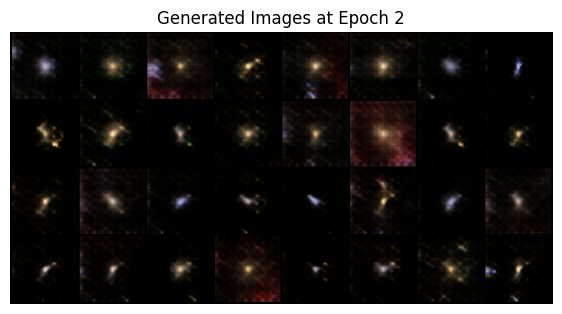

Epoch [2/5] Batch 300/482                   Loss D: 0.6426, loss G: 1.1509


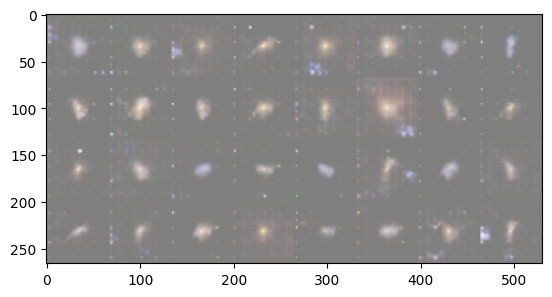

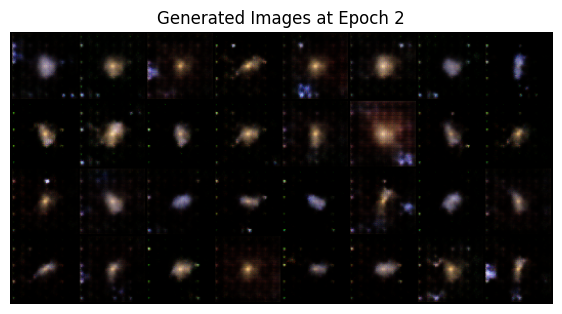

Epoch [2/5] Batch 350/482                   Loss D: 0.7329, loss G: 0.5911


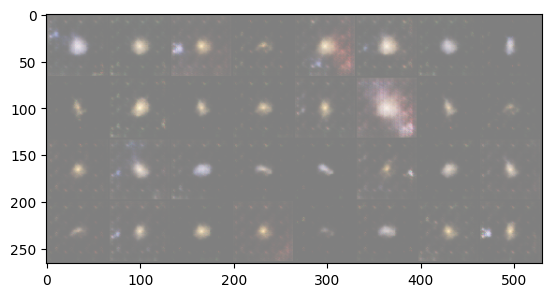

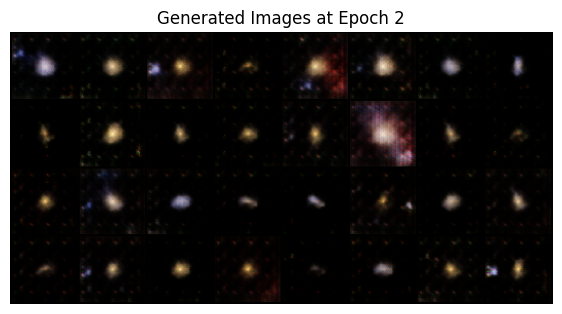

Epoch [2/5] Batch 400/482                   Loss D: 0.4745, loss G: 2.2031


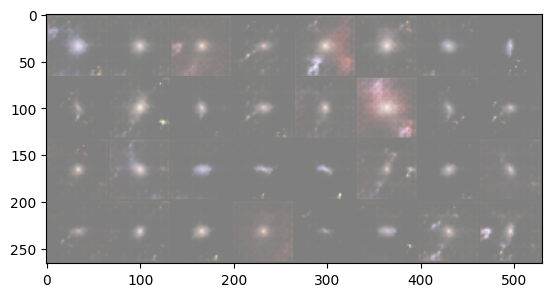

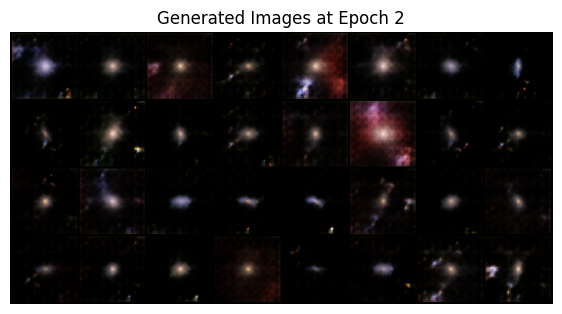

Epoch [2/5] Batch 450/482                   Loss D: 0.3651, loss G: 1.4210


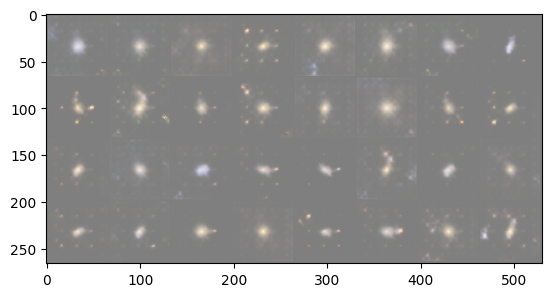

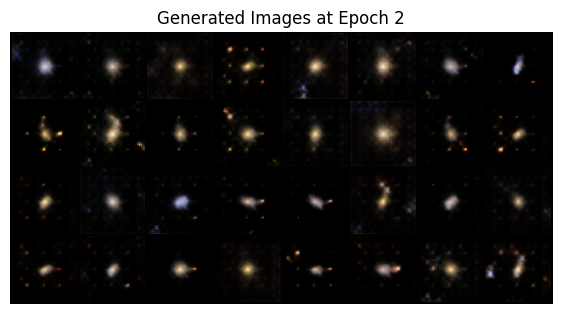

Epoch [3/5] Batch 0/482                   Loss D: 0.3473, loss G: 1.7066


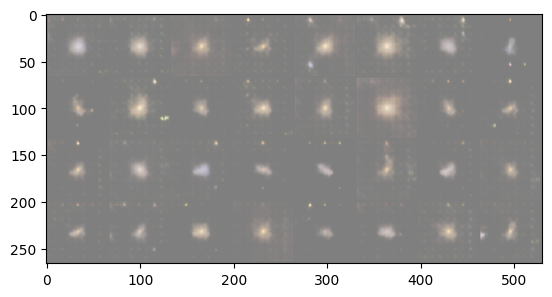

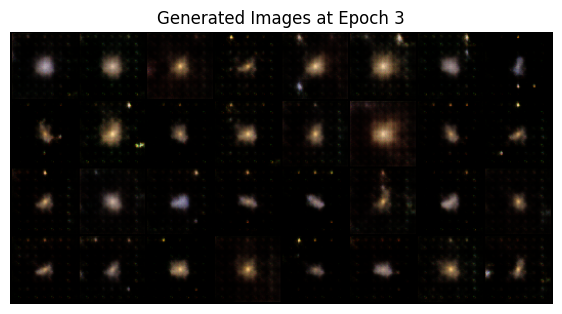

Epoch [3/5] Batch 50/482                   Loss D: 0.4401, loss G: 1.1889


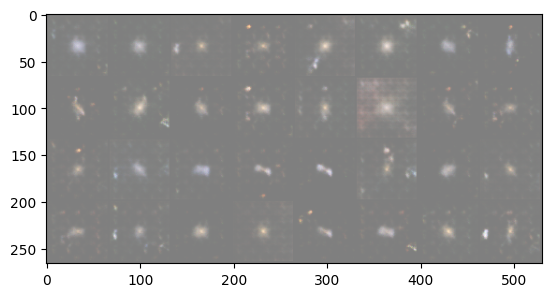

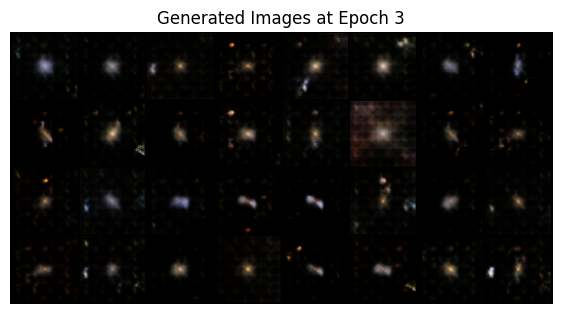

Epoch [3/5] Batch 100/482                   Loss D: 0.5023, loss G: 1.1265


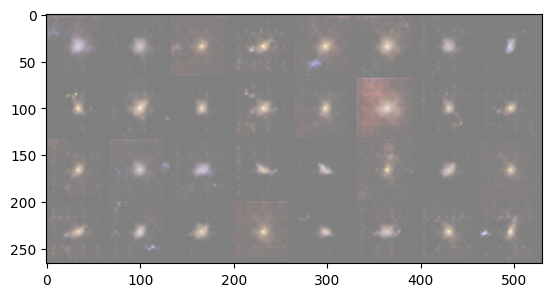

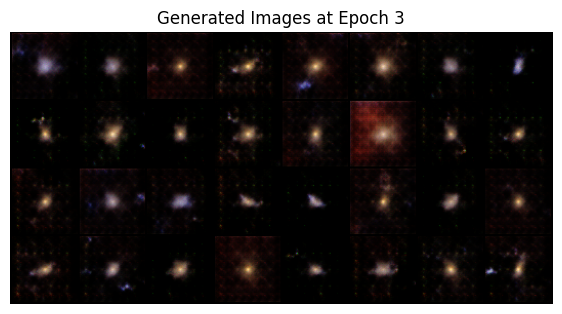

Epoch [3/5] Batch 150/482                   Loss D: 0.3008, loss G: 2.5789


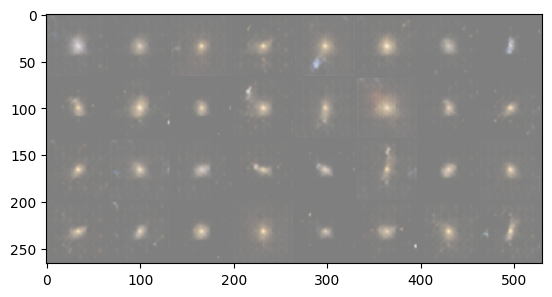

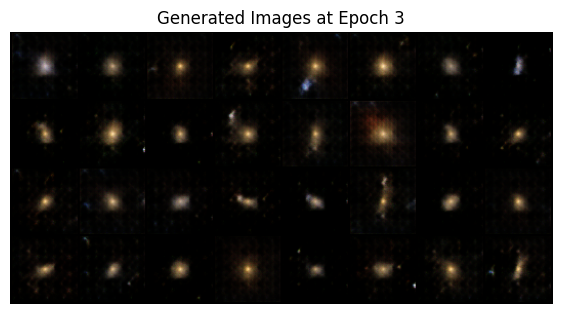

Epoch [3/5] Batch 200/482                   Loss D: 0.3554, loss G: 2.0983


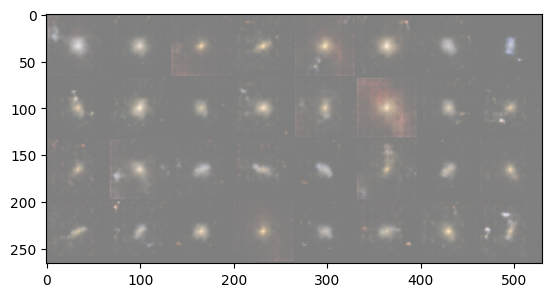

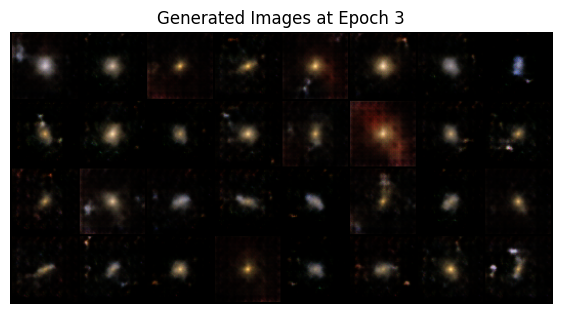

Epoch [3/5] Batch 250/482                   Loss D: 0.3213, loss G: 2.5637


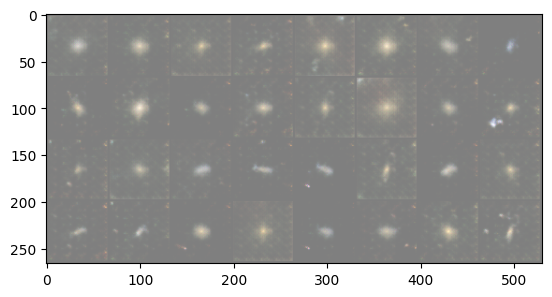

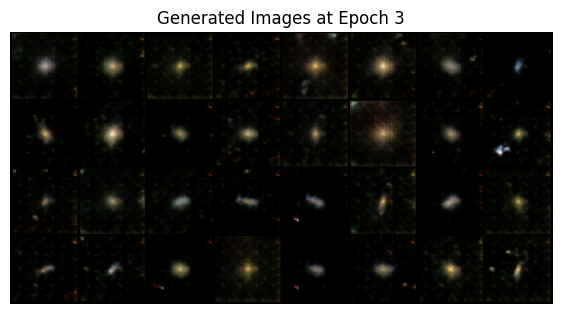

Epoch [3/5] Batch 300/482                   Loss D: 0.6397, loss G: 0.8599


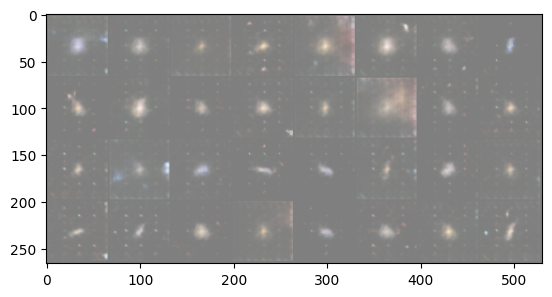

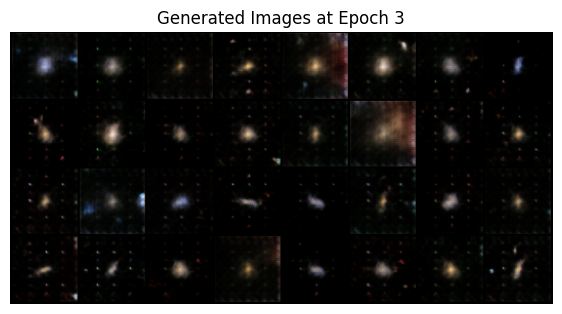

Epoch [3/5] Batch 350/482                   Loss D: 0.6819, loss G: 1.6632


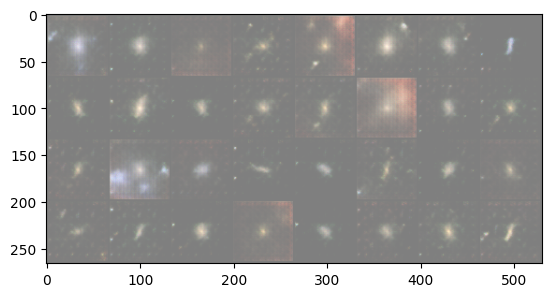

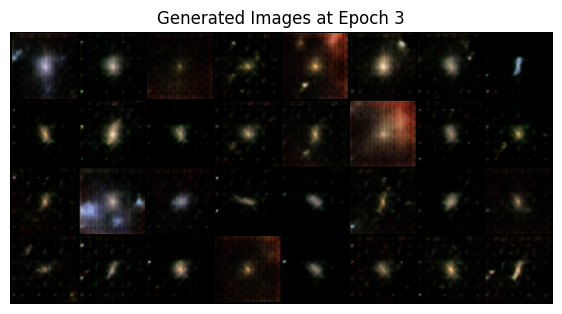

Epoch [3/5] Batch 400/482                   Loss D: 0.4017, loss G: 2.1205


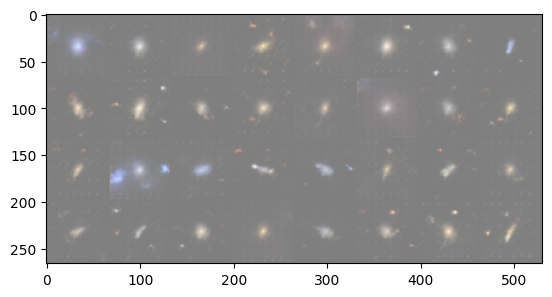

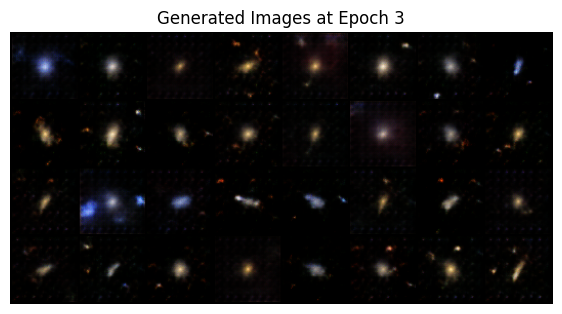

Epoch [3/5] Batch 450/482                   Loss D: 0.4758, loss G: 2.9511


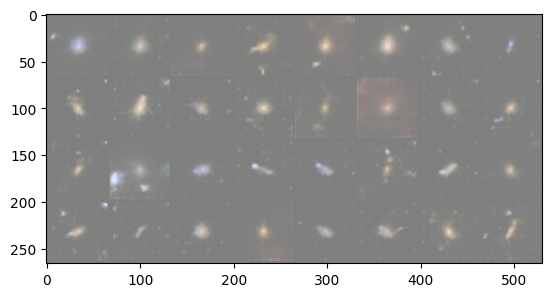

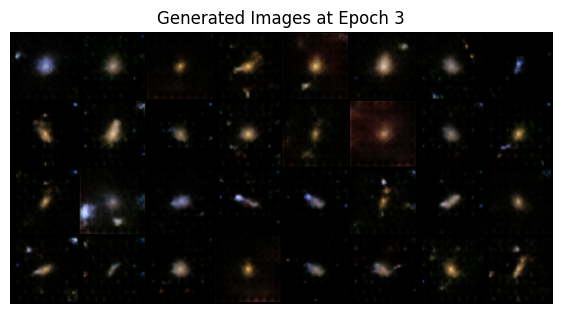

Epoch [4/5] Batch 0/482                   Loss D: 0.7570, loss G: 4.4414


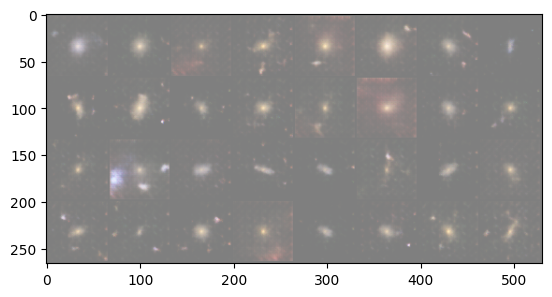

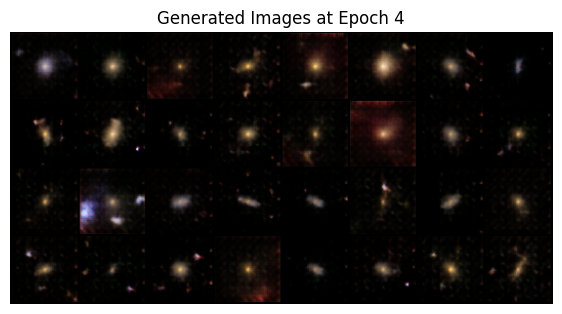

Epoch [4/5] Batch 50/482                   Loss D: 0.3893, loss G: 1.6506


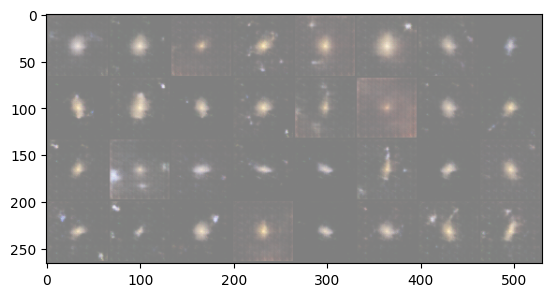

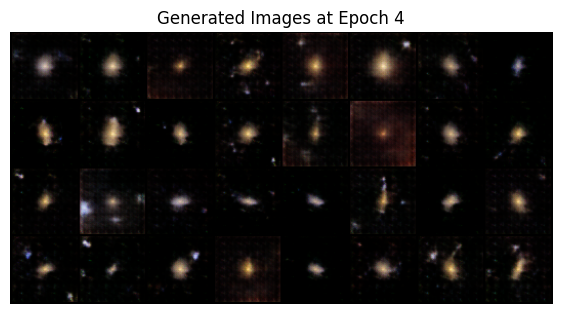

Epoch [4/5] Batch 100/482                   Loss D: 0.5094, loss G: 1.1335


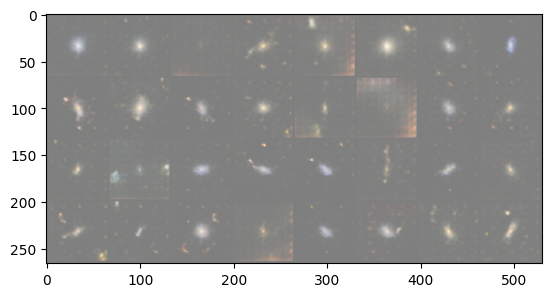

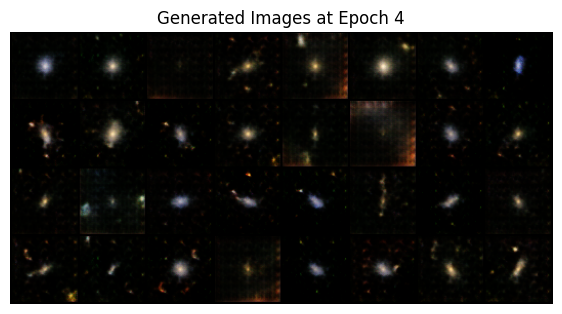

Epoch [4/5] Batch 150/482                   Loss D: 0.3573, loss G: 2.0353


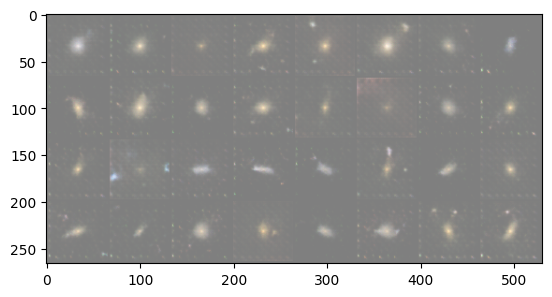

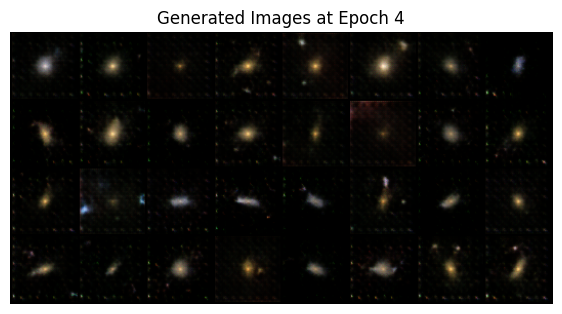

Epoch [4/5] Batch 200/482                   Loss D: 0.4693, loss G: 2.0729


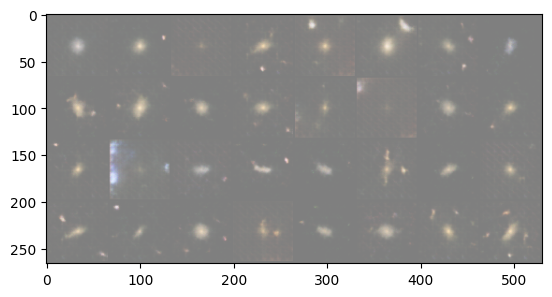

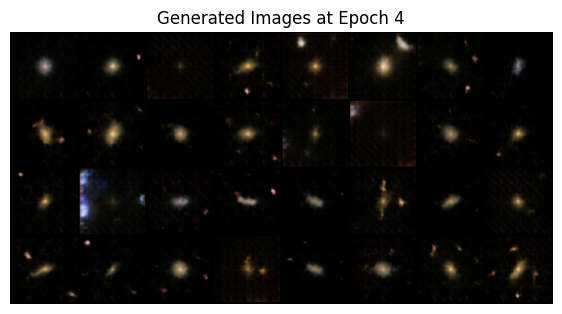

Epoch [4/5] Batch 250/482                   Loss D: 0.4623, loss G: 0.8713


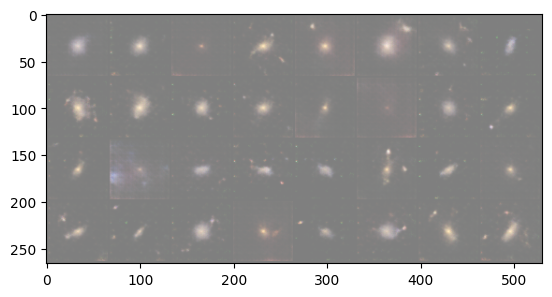

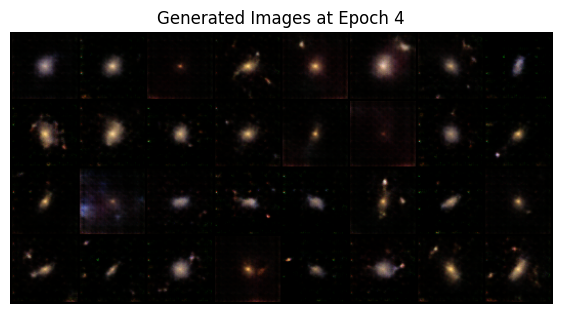

Epoch [4/5] Batch 300/482                   Loss D: 0.4874, loss G: 3.0047


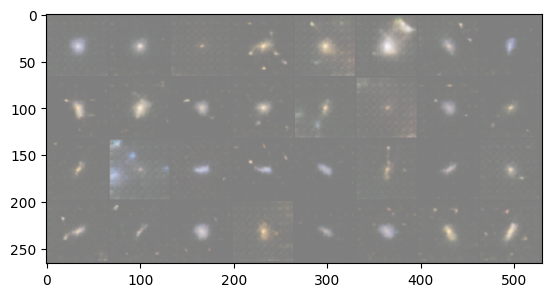

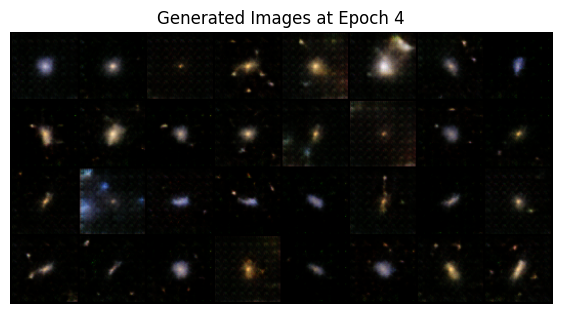

Epoch [4/5] Batch 350/482                   Loss D: 0.3945, loss G: 1.6448


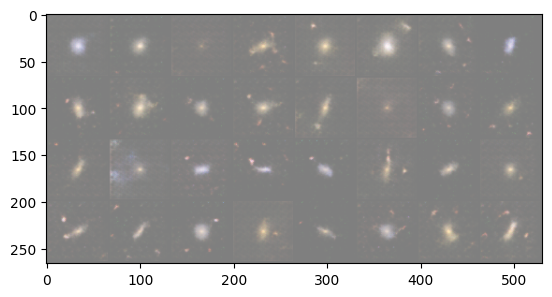

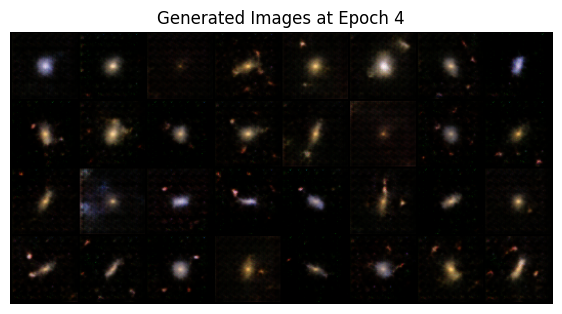

Epoch [4/5] Batch 400/482                   Loss D: 0.5735, loss G: 1.8949


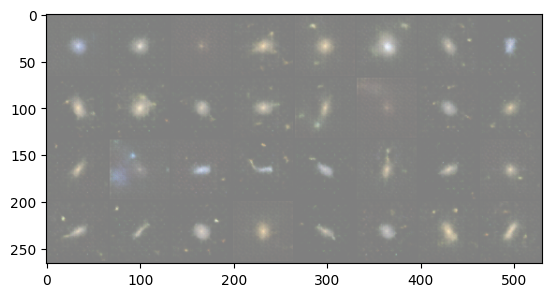

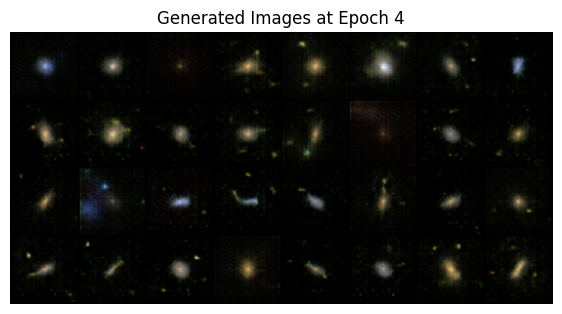

Epoch [4/5] Batch 450/482                   Loss D: 0.4212, loss G: 2.4015


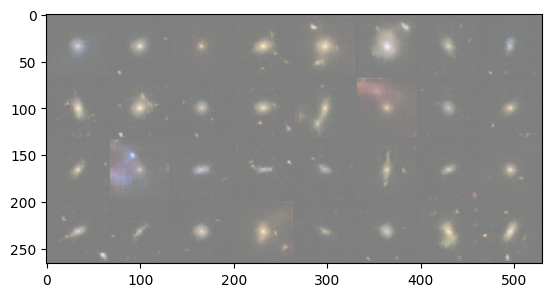

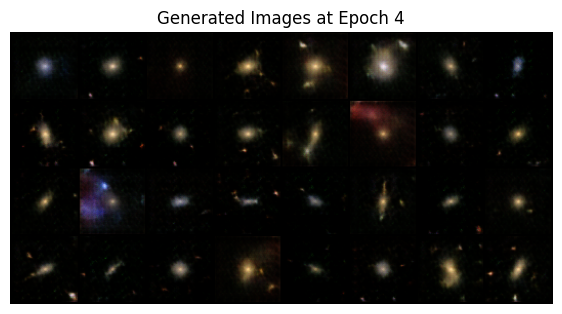

In [17]:
gen.train()
disc.train()

for epoch in range(NUM_EPOCHS):
    for batch_idx, (real, _ ) in enumerate(dataloader):
        real = real.to(device)

        noise = torch.randn((BATCH_SIZE, Z_DIM, 1, 1)).to(device)
        fake = gen(noise)


        disc_real = disc(real).reshape(-1)
        loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
        disc_fake = disc(fake.detach()).reshape(-1)
        loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        loss_disc = (loss_disc_real + loss_disc_fake) / 2
        disc.zero_grad()
        loss_disc.backward()
        opt_disc.step()


        output = disc(fake).reshape(-1)
        loss_gen = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()


        if batch_idx % 50 == 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(dataloader)} \
                  Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
            )
            with torch.no_grad():
                fake = gen(fixed_noise)
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
                show_tensor_images(img_grid_fake)
                save_and_display_images(fake,epoch,batch_idx)





In [18]:
import cv2
import os


images_folder = "generated_images"


image_files = sorted([os.path.join(images_folder, file) for file in os.listdir(images_folder) if file.endswith('.png')])


fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video_output = cv2.VideoWriter('generated_images_video.mp4', fourcc, 10.0, (256, 256))  # Adjust frame size as needed

for image_file in image_files:
    img = cv2.imread(image_file)
    video_output.write(img)


video_output.release()